# Initialization

## Inport modules

In [1]:
%matplotlib ipympl
import os, sys
import time
import pyvisa
import warnings
import numpy as np
import qcodes as qc
import plotly.graph_objects as go
import matplotlib.pyplot as plt

def find_qcodes_local_dir():
    dirpath = os.getcwd()
    while True:
        dirpath, folder_name = os.path.split(dirpath)
        if folder_name == 'QCoDeS_local':
            return os.path.join(dirpath, folder_name)
        if not folder_name:  # Reached the root directory
            return None
qcodes_local_dir = find_qcodes_local_dir()
sys.path.append(f'{qcodes_local_dir}')

from tqdm import tqdm
from pprint import pprint
from time import sleep, monotonic, time
from IPython.display import clear_output
from qcodes.dataset.measurements import Measurement
from qcodes.utils.metadata import diff_param_values
from qcodes.dataset.plotting import plot_dataset, plot_by_id
from qcodes import Parameter, ManualParameter, ScaledParameter
from qcodes.instrument.specialized_parameters import ElapsedTimeParameter
from sweeps_v2 import do1d, do2d, time_sweep, measure_until, do1d_until

from Init3 import *

print('Imported all modules, QCoDeS version:', qc.__version__, 'initialized')

# warnings.filterwarnings('ignore')

Imported all modules, QCoDeS version: 0.38.1 initialized
找到 2 個 .db 文件:
1. c:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2_flux015B\001\001_2025-03-26_01.db
2. c:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2_flux015B\001\LT\LT_2025-03-27_01.db
初始化數據庫: c:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2_flux015B\001\LT\LT_2025-03-27_01.db
Imported all modules, QCoDeS version: 0.38.1 initialized


In [2]:
def find_qcodes_local_dir():
    dirpath = os.getcwd()
    while True:
        dirpath, folder_name = os.path.split(dirpath)
        if folder_name == 'QCoDeS_local':
            return os.path.join(dirpath, folder_name)
        if not folder_name:  # Reached the root directory
            return None
qcodes_local_dir = find_qcodes_local_dir()
qcodes_local_dir

'c:\\Users\\admin\\Documents\\GitHub\\QCoDeS_local'

In [4]:
def find_init_fridge_v2_py():
    for root, dirs, files in os.walk(qcodes_local_dir):
        if 'init_fridge_v2.py' in files:
            return os.path.join(root, 'init_fridge_v2.py')
    return None

init_fridge_v2_py_path = find_init_fridge_v2_py()
init_fridge_v2_py_path

'c:\\Users\\admin\\Documents\\GitHub\\QCoDeS_local\\init_fridge_v2.py'

In [5]:
fridge_name = 'BF1'
%run "{init_fridge_v2_py_path}" {fridge_name}

Found init_BF1_v2.py at: c:\Users\admin\Documents\GitHub\QCoDeS_local\fridge_specific\init_BF1_v2.py
Device: TCPIP0::K-E5080B-02870::inst0::INSTR
IDN: Keysight Technologies,E5080B,MY59202870,A.15.10.08

Error connecting to ASRL1::INSTR: VI_ERROR_TMO (-1073807339): Timeout expired before operation completed.
Error connecting to ASRL3::INSTR: VI_ERROR_TMO (-1073807339): Timeout expired before operation completed.
Device: GPIB0::7::INSTR
IDN: KEITHLEY INSTRUMENTS,MODEL DMM6500,04518181,1.7.7b

Connected to: KEITHLEY INSTRUMENTS DMM6500 (serial:04518181, firmware:1.7.7b) in 0.02s
Added Keithley DMM6500 at GPIB0::7::INSTR to the station.
Device: GPIB0::23::INSTR
IDN: KEITHLEY INSTRUMENTS INC.,MODEL 2000,0775539,A13  /A02  

Connected to: KEITHLEY INSTRUMENTS INC. 2000 (serial:0775539, firmware:A13  /A02) in 0.07s


[K2000(Keithley2000)] Snapshot: Could not update parameter: trigger_count


Added Keithley 2000 at GPIB0::23::INSTR to the station.
Initialized IVVI-rack in 0.02s
Added IVVI at ASRL3::INSTR to the station.
Connected to: AMERICAN MAGNETICS INC. 430 (serial:430-22-111, firmware:3.15) in 2.41s
Connected to: AMERICAN MAGNETICS INC. 430 (serial:430-22-113, firmware:3.15) in 1.29s
Connected to: AMERICAN MAGNETICS INC. 430 (serial:430-22-114, firmware:3.15) in 1.36s
x, IP: 169.254.115.1, Port: 7180
y, IP: 169.254.115.2, Port: 7180
z, IP: 169.254.115.3, Port: 7180
Added x to the station.
Added y to the station.
Added z to the station.
Added AMI430_3D to the station.

Station list:
{'AMI430_3D': <AMI430_3D: AMI430_3D>,
 'DMM6500': <Keithley_6500: DMM6500>,
 'K2000': <Keithley2000: K2000>,
 'ivvi': <IVVI: ivvi>,
 'x': <AMI430: x>,
 'y': <AMI430: y>,
 'z': <AMI430: z>}


In [6]:
snapshot_of_station = station.snapshot()
pprint(snapshot_of_station)

{'components': {},
 'config': None,
 'instruments': {'AMI430_3D': {'__class__': 'qcodes.instrument_drivers.american_magnetics.AMI430.AMI430_3D',
                               'functions': {},
                               'label': 'AMI430_3D',
                               'name': 'AMI430_3D',
                               'parameters': {'IDN': {'__class__': 'qcodes.parameters.parameter.Parameter',
                                                      'full_name': 'AMI430_3D_IDN',
                                                      'instrument': 'qcodes.instrument_drivers.american_magnetics.AMI430.AMI430_3D',
                                                      'instrument_name': 'AMI430_3D',
                                                      'inter_delay': 0,
                                                      'label': 'IDN',
                                                      'name': 'IDN',
                                                      'post_delay': 0,
         

## IVVI sensitive check

In [7]:
ivvi.dac1.step = 100
ivvi.dac1.inter_delay = 0.01
ivvi.dac2.step = 100
ivvi.dac2.inter_delay = 0.01
ivvi.dac3.step = 5
ivvi.dac3.inter_delay = 0.1

In [6]:
ivvi.dac5.step = 10
ivvi.dac5.inter_delay = 0.1
ivvi.dac1(0)
ivvi.dac2(0)
ivvi.dac3(0)
ivvi.dac4(0)
ivvi.dac5(0)

#  Database initialisation

In [8]:
def find_init_database_v2_py():
    for root, dirs, files in os.walk(qcodes_local_dir):
        if 'init_database_v2.py' in files:
            return os.path.join(root, 'init_database_v2.py')
    return None

init_database_v2_py_path = find_init_database_v2_py()
init_database_v2_py_path

'c:\\Users\\admin\\Documents\\GitHub\\QCoDeS_local\\init_database_v2.py'

In [9]:
reuse = True
%run "{init_database_v2_py_path}" {reuse}

Using existing database file:
c:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2_flux015B\001\LT\LT_2025-03-27_01.db


## Defining scaled parameters

### IVVI version

In [10]:
Irange = Parameter('Irange', label='current range', unit='', set_cmd=None, get_cmd=None)
Vrange = Parameter('Vrange', label='voltage range', unit='', set_cmd=None, get_cmd=None)
TGrange = Parameter('TGrange', label='Top gate range', unit='', set_cmd=None, get_cmd=None)
TGrange2 = Parameter('TGrange2', label='Top gate range2', unit='', set_cmd=None, get_cmd=None)

#division paraemtrs required for simplier update: they used as an argument for scaled paraemtrs of sorce instruments

Irange_division = Parameter('Irange_division', 
                            label='scaled current range', unit='', 
                            set_cmd=None, get_cmd=lambda : 1000 / Irange())

Vrange_division = Parameter('Vrange_division', 
                            label='scaled voltage range', unit='', 
                            set_cmd=None, get_cmd=lambda : 1000 / Vrange())

TGrange_division = Parameter('TGrange_division', 
                             label='scaled Top gate range', unit='', 
                             set_cmd=None, get_cmd=lambda : 1000 / TGrange())

TGrange_division2 = Parameter('TGrange_division2', 
                             label='scaled Top gate range2', unit='', 
                             set_cmd=None, get_cmd=lambda : 1000 / TGrange2())

Irange_AC_division = Parameter('Irange_AC_division', 
                               label='scaled current range for lockin', unit='', 
                               set_cmd=None, get_cmd=lambda : 100 / Irange())

Vrange_AC_division = Parameter('Vrange_AC_division', 
                               label='scaled voltage range for lockin', unit='', 
                               set_cmd=None, get_cmd=lambda : 100 / Vrange())

Gain_K1 = Parameter('Gain_K1', label='Gain K1', unit='', set_cmd=None, get_cmd=None)
Gain_K2 = Parameter('Gain_K2', label='Gain K2', unit='', set_cmd=None, get_cmd=None)
Gain_L1 = Parameter('Gain_L1', label='Gain L1', unit='', set_cmd=None, get_cmd=None)
Gain_L2 = Parameter('Gain_L2', label='Gain L2', unit='', set_cmd=None, get_cmd=None)

#Add components
station.add_component(Irange)
station.add_component(Vrange)
station.add_component(TGrange)
station.add_component(TGrange2)

station.add_component(Irange_division)
station.add_component(Vrange_division)
station.add_component(TGrange_division)
station.add_component(TGrange_division2)

station.add_component(Irange_AC_division)
station.add_component(Vrange_AC_division)
                             
station.add_component(Gain_K1)
station.add_component(Gain_K2)
station.add_component(Gain_L1)
station.add_component(Gain_L2)
print('\nStation list:')
pprint(station.components)


Station list:
{'AMI430_3D': <AMI430_3D: AMI430_3D>,
 'DMM6500': <Keithley_6500: DMM6500>,
 'Gain_K1': <qcodes.parameters.parameter.Parameter: Gain_K1 at 2838889301760>,
 'Gain_K2': <qcodes.parameters.parameter.Parameter: Gain_K2 at 2838889118160>,
 'Gain_L1': <qcodes.parameters.parameter.Parameter: Gain_L1 at 2838889118736>,
 'Gain_L2': <qcodes.parameters.parameter.Parameter: Gain_L2 at 2838889119648>,
 'Irange': <qcodes.parameters.parameter.Parameter: Irange at 2838880035456>,
 'Irange_AC_division': <qcodes.parameters.parameter.Parameter: Irange_AC_division at 2838889304016>,
 'Irange_division': <qcodes.parameters.parameter.Parameter: Irange_division at 2838880037376>,
 'K2000': <Keithley2000: K2000>,
 'TGrange': <qcodes.parameters.parameter.Parameter: TGrange at 2838880036080>,
 'TGrange2': <qcodes.parameters.parameter.Parameter: TGrange2 at 2838880038048>,
 'TGrange_division': <qcodes.parameters.parameter.Parameter: TGrange_division at 2838889301856>,
 'TGrange_division2': <qcodes.

## Parameters - update here during measuerements

In [11]:
Irange.set(10e-6) #Unit Amp V=IR, 1V= 1e-6 x 1MOhm=1e-7 x 10MOhm
Vrange.set(1e-3)
TGrange.set(15)
TGrange2.set(15)
Gain_K1.set(100)
Gain_K2.set(100)
# Gain_K3.set(1e2)
Gain_L1.set(Gain_K1())
Gain_L2.set(Gain_K2())

## DC parameters

In [12]:
appl_current = ScaledParameter(ivvi.dac1, division = Irange_division, name = 'appl_current', unit = 'A')
appl_voltage = ScaledParameter(ivvi.dac2, division = Vrange_division, name = 'appl_voltage', unit = 'V')
# appl_TG = ScaledParameter(ivvi.dac3, division = TGrange_division, name = 'appl_TG', unit = 'V')
# appl_TG2 = ScaledParameter(ivvi.dac4, division = TGrange_division, name = 'appl_TG2', unit = 'V')
# appl_TG7 = ScaledParameter(ivvi.dac7, division = TGrange_division2, name = 'appl_TG7', unit = 'V')
# appl_TG9 = ScaledParameter(ivvi.dac9, division = TGrange_division2, name = 'appl_TG9', unit = 'V')
# appl_TG11 = ScaledParameter(ivvi.dac11, division = TGrange_division2, name = 'appl_TG11', unit = 'V')

# meas_voltage_K1 = ScaledParameter(DMM6500.amplitude, division = Gain_K1, name = 'meas_voltage_K1', unit = 'V')
meas_voltage_K2 = ScaledParameter(DMM6500.amplitude, division = Gain_K2, name = 'meas_voltage_K2', unit = 'V')

# meas_leakage = ScaledParameter(DMM6500.amplitude, division = Gain_K2, name = 'meas_leakage', unit = 'A')

# meas_current_K1 = ScaledParameter(DMM6500.amplitude, division = Gain_K1, name = 'meas_current_K1', unit = 'A')
meas_current_K2 = ScaledParameter(DMM6500.amplitude, division = Gain_K2, name = 'meas_current_K2', unit = 'A')

station.add_component(appl_current)
station.add_component(appl_voltage)
# station.add_component(appl_TG)
# station.add_component(appl_TG2)
# station.add_component(appl_TG7)
# station.add_component(appl_TG9)
# station.add_component(appl_TG11)
# station.add_component(meas_voltage_K1)
station.add_component(meas_voltage_K2)
# station.add_component(meas_leakage)
# station.add_component(meas_current_K1)
station.add_component(meas_current_K2)

'meas_current_K2'

In [75]:
ivvi.dac1(1000)

In [33]:
appl_current(0)

In [ ]:
I=1e-6
appl_current(I)
sleep(1)
V=meas_voltage_K2()
R=V/I
print(R)

##  AC parameters

In [ ]:
appl_current_AC = ScaledParameter(lockin_1.amplitude, division = Irange_AC_division, name = 'appl_current_AC', unit = 'A')
appl_voltage_AC = ScaledParameter(lockin_1.amplitude, division = Vrange_AC_division, name = 'appl_voltage_AC', unit = 'V')

station.add_component(appl_current_AC)
station.add_component(appl_voltage_AC)

meas_voltage_AC_L1 = ScaledParameter(lockin_1.X, division = Gain_L1, name = 'meas_voltage_Lockin1', unit = 'V')
meas_current_AC_L1 = ScaledParameter(lockin_1.X, division = Gain_L1, name = 'meas_current_Lockin1', unit = 'A')
meas_phase_AC_L1 = ScaledParameter(lockin_1.P, division = 1, name = 'meas_phase_Lockin1', unit = 'degree')


# meas_voltage_AC_L2 = ScaledParameter(lockin_2.X, division = Gain_L2, name = 'meas_voltage_Lockin2', unit = 'V')
# meas_current_AC_L2 = ScaledParameter(lockin_2.X, division = Gain_L2, name = 'meas_current_Lockin2', unit = 'A')
# meas_phase_AC_L2 = ScaledParameter(lockin_2.P, division = 1, name = 'meas_phase_Lockin1', unit = 'degree')

station.add_component(meas_voltage_AC_L1)
station.add_component(meas_current_AC_L1)
station.add_component(meas_phase_AC_L1)

# station.add_component(meas_voltage_AC_L2)
# station.add_component(meas_current_AC_L2)

meas_voltage_AC_L1_R = ScaledParameter(lockin_1.R, division = Gain_L1, name = 'meas_voltage_R_Lockin1', unit = 'V')
# meas_voltage_AC_L2_R = ScaledParameter(lockin_2.R, division = Gain_L2, name = 'meas_voltage_R_Lockin2', unit = 'V')

station.add_component(meas_voltage_AC_L1_R)
# station.add_component(meas_voltage_AC_L2_R)

In [ ]:
meas_voltage_AC_L1_P = ScaledParameter(lockin_1.P, division = 1, name = 'meas_voltage_Lockin1_P', unit = 'degree')
meas_current_AC_L1_P = ScaledParameter(lockin_1.P, division = 1, name = 'meas_current_Lockin1_P', unit = 'degree')

# meas_voltage_AC_L2_P = ScaledParameter(lockin_2.P, division = 1, name = 'meas_voltage_Lockin2_P', unit = 'degree')
# meas_current_AC_L2_P = ScaledParameter(lockin_2.P, division = 1, name = 'meas_current_Lockin2_P', unit = 'degree')

station.add_component(meas_voltage_AC_L1_P)
station.add_component(meas_current_AC_L1_P)

# station.add_component(meas_voltage_AC_L2_P)
# station.add_component(meas_current_AC_L2_P)

## Another useful example: magnet using dac (Janis)

>2231.2 G per A => 0.22312 T per A<br>
I source 10mA per V => 1e-5 A per 1mV<br>
result: 0.22312 T/A * 1e-5 A/mV

In [13]:
# def get_R_from_IV(dataid):
#     dataset = qc.load_by_id(dataid)
#     voltage = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
#     current = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
#     fit_values = np.polyfit(current,voltage,1)
    
#     return fit_values[0]

dataset = qc.load_by_id(1)

def get_R_from_IV_2(dataid):
    dataset = qc.load_by_id(dataid)
    voltage = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
    current = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
    fit_values = np.polyfit(current,voltage,1)

    return fit_values[0]

def get_R_from_IV(dataid):
    dataset = qc.load_by_id(dataid)
    para_list = dataset.parameters.split(",")
    voltage = dataset.get_parameter_data()[para_list[1]][para_list[1]]
    current = dataset.get_parameter_data()[para_list[1]][para_list[0]]
    fit_values = np.polyfit(current,voltage,1)
    return fit_values[0]


def get_R_from_IV_K2(dataid):
    dataset = qc.load_by_id(dataid)
    voltage = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
    current = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']
    fit_values = np.polyfit(current,voltage,1)
    return fit_values[0]

def autosave_plot_by_id(run_id, save_path):
    fig, ax = plt.subplots()
    plot_by_id(run_id, axes=ax)
    plt.savefig(save_path)
    plt.close()

def get_detaset_info(dataset=dataset):
    run_id = dataset.captured_run_id
    exp_name = dataset.exp_name
    sample_name = dataset.sample_name
    name = dataset.name
    description = dataset.description
    sample_junction = extract_sample_junction(sample_name)
    return run_id, exp_name, sample_name, sample_junction, name, description

def extract_sample_junction(sample_name):
    """Extracts the complete sample junction from the provided sample name.

    Args:
      sample_name: The name of the sample containing the junction information.

    Returns:
      The extracted sample junction, or None if not found.
    """

    delimiter = "_J"
    if delimiter in sample_name:
        # +3 to include "_J"
        return sample_name[:sample_name.find(delimiter) + 3]
    else:
        return None

def IV(run_id=1):
    dataset = qc.load_by_id(run_id)
    R = get_R_from_IV(run_id)
    run_id, exp_name, sample_name, sample_junction, name, description = get_detaset_info(
        dataset)
    df = dataset.to_pandas_dataframe().reset_index()
    para_list = dataset.parameters.split(",")

    # Create a Plotly trace
    trace = go.Scatter(x=df[para_list[0]], y=df[para_list[1]]*1e3, mode='lines', name='Voltage vs. Current')

    # Create layout with micro-scale y-axis
    layout = go.Layout(title=f'<b>#{run_id} {exp_name}</b> {sample_name}, R_fit={R:.4f} Ω', title_font=dict(size=28),
                       xaxis=dict(title=para_list[0], tickfont=dict(size=16),title_font=dict(size=20)),
                       yaxis=dict(title=f"{para_list[1]} mV", tickfont=dict(size=16),title_font=dict(size=20)), 
                       width=1080, height=960,
                       margin=dict(l=10, r=10, t=50, b=10))

    # Create the figure
    fig = go.Figure(data=[trace], layout=layout)
    
    fig.show()

def IV_diff(run_id=1):
    import numpy as np
    import plotly.graph_objs as go
    from scipy.signal import find_peaks
    dataset = qc.load_by_id(run_id)

    df = dataset.to_pandas_dataframe().reset_index()
    para_list = dataset.parameters.split(",")

    current = df[para_list[0]].tolist()
    voltage = df[para_list[1]].tolist()

    # Compute differential of voltage with respect to current
    differential_voltage = np.diff(voltage) / np.diff(current)

    # Since the differential will have one less data point, adjust the current data
    # to have the same length as the differential data
    current = current[:-1]

    # Find peaks in the differential signal
    peaks, _ = find_peaks(differential_voltage)

    # Extract peak current and peak differential voltage values
    peak_current = [current[i] for i in peaks]
    peak_voltage_diff = [differential_voltage[i] for i in peaks]

    # Sort the peaks based on their values
    sorted_peak_indices = np.argsort(peak_voltage_diff)[::-1]  # Sort in descending order
    top_two_peak_indices = sorted_peak_indices[:2]  # Select the top two indices

    # Extract the top two peaks
    top_two_peak_current = [peak_current[i] for i in top_two_peak_indices]
    top_two_peak_voltage_diff = [peak_voltage_diff[i] for i in top_two_peak_indices]

    # Calculate the center points of the top two peaks
    center_points = [(top_two_peak_current[i] + top_two_peak_current[i+1]) / 2 for i in range(len(top_two_peak_current) - 1)]

    # Calculate the difference between the top two biggest peaks
    peak_difference = abs(top_two_peak_current[0] - top_two_peak_current[1])

    # Determine the appropriate unit for current
    if peak_difference >= 1e-3:
        unit = "mA"
        conversion_factor = 1e3
    elif peak_difference >= 1e-6:
        unit = "μA"
        conversion_factor = 1e6
    else:
        unit = "nA"
        conversion_factor = 1e9

    # Determine the appropriate unit for current
    if peak_difference >= 1e-3:
        unit = "mA"
    elif peak_difference >= 1e-6:
        unit = "μA"
    elif peak_difference >= 1e-9:
        unit = "nA"
    else:
        unit = "pA"

    # Create a Plotly trace for the differential
    trace_diff = go.Scatter(x=[c * conversion_factor for c in current], y=differential_voltage, mode='lines', name='d(Voltage)/d(Current)')
    # Add markers for the top two peaks
    trace_top_two_peaks = go.Scatter(x=[p * conversion_factor for p in top_two_peak_current], y=top_two_peak_voltage_diff, mode='markers', marker=dict(color='red'), name='Top Two Peaks')
    # Add markers for the center points
    trace_center_points = go.Scatter(x=center_points, y=[0]*len(center_points), mode='markers', marker=dict(color='blue', symbol='cross'), name='Center Points')

    # Create layout
    layout = go.Layout(title=f'Run #{id} I vs. dV/dI',
                    xaxis=dict(title=f'Current ({unit})'),
                    yaxis=dict(title='d(Voltage)/d(Current)'),
                    legend=dict(orientation="h", yanchor="top", y=1.10, xanchor="center", x=0.5),
                    width=600, height=600  
                    )

    # Create the figure
    fig = go.Figure(data=[trace_diff, trace_top_two_peaks, trace_center_points], layout=layout)

    # Add annotation for the current value of center points
    for i, center_point in enumerate(center_points):
        fig.add_annotation(
            x=center_point * conversion_factor,
            y=0, #0.4 * max(differential_voltage),
            text=f'Center Point: {center_point * conversion_factor:.3f}{unit} <br> Peak difference: {peak_difference*conversion_factor:.3f} {unit}',
            showarrow=True,
            arrowhead=2,
            arrowsize=1,
            arrowwidth=2,
            arrowcolor='black',
            ax=-100,
            ay=-200 - 30 * i
        )

    # Plot the figure
    fig.show()

def get_Mag(show=True):
    Mag_x = magnet_x.field()
    Mag_y = magnet_y.field()
    Mag_z = magnet_z.field()
    if show:
        print(f"Mag_x: {Mag_x*1e3:.6f} mT")
        print(f"Mag_y: {Mag_y*1e3:.6f} mT")
        print(f"Mag_z: {Mag_z*1e3:.6f} mT")
    else: 
        return Mag_x, Mag_y, Mag_z

In [ ]:
appl_current(0.5e-6)
appl_current_AC(10e-9)

In [ ]:
df = dataset.to_pandas_dataframe().reset_index()
df

# Simple IVs

## IV

In [30]:
ivvi.dac1.step = 100
ivvi.dac1.inter_delay = 0.0001

In [42]:
Irange.set(1000e-6) 

In [82]:
Irange.set(10e-9)

In [108]:
appl_current(0)

In [69]:
I = 500e-6
# I = 10e-9
appl_current(-I)
sleep(1)
Mag_x, Mag_y, Mag_z = get_Mag(False)
# exp = qc.new_experiment('IV', sample_name='019_1kOhm')
exp = qc.new_experiment('IV', sample_name=f'002-01_20-21-31-32@({Mag_x*1e3:.2f},{Mag_y*1e3:.2f},{Mag_z*1e3:.2f})mT')

dataid = do1d(appl_current, -I, I, 101, 0.0001,meas_voltage_K2,)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero() 

appl_current(0)
# plot = plot_by_id(dataid)
fig = plot_combined_iv_dvdi(dataid)
clear_output(wait=True)
print(f"R = {get_R_from_IV(dataid)}")
fig

R = 31.267036356260917


In [79]:
fig = plot_combined_iv_dvdi(51)

Number of points for each parameter in dataset 51:
- meas_voltage_K2 (dependent): 501 points
- appl_current     (setpoint): 501 unique points, from -1.00e-05 to 1.00e-05, step size: 4.00e-08
計算微分電阻 dV/dI，使用電壓: meas_voltage_K2 和電流: appl_current
已添加dV_dI列到數據框
<class 'pandas.core.frame.DataFrame'>
Int64Index: 501 entries, 0 to 500
Data columns (total 3 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   appl_current     501 non-null    float64
 1   meas_voltage_K2  501 non-null    float64
 2   dV_dI            501 non-null    float64
dtypes: float64(3)
memory usage: 15.7 KB
None
       appl_current  meas_voltage_K2        dV_dI
count    501.000000     5.010000e+02   501.000000
mean       0.000000    -2.280373e-05   354.195185
std        0.000006     1.982704e-03   484.728895
min       -0.000010    -3.539163e-03    -0.522801
25%       -0.000005    -1.642825e-03   347.901250
50%        0.000000    -7.956911e-08   373.900000
75%        0

In [16]:
I = 20e-6
# I = 10e-9
appl_current(-I)
sleep(1)
Mag_x, Mag_y, Mag_z = get_Mag(False)
# exp = qc.new_experiment('IV', sample_name='019_1kOhm')
exp = qc.new_experiment('IV', sample_name=f'019-01_29-30-28-27@({Mag_x*1e3:.2f},{Mag_y*1e3:.2f},{Mag_z*1e3:.2f})mT')

dataid = do1d(appl_current, -I ,I, 101, 0.01,meas_voltage_K2,)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()

appl_current(0)
# plot = plot_by_id(dataid)
print(f"R = {get_R_from_IV(dataid)}")  
fig = plot_combined_iv_dvdi(dataid)
# clear_output()
# fig

There is (are) already experiment(s) with the name of IV and sample name of 019-01_29-30-28-27@(-30.00,-0.28,-0.00)mT in the database.


Starting experimental run with id: 141. 


100%|██████████| 101/101 [00:05<00:00, 19.59it/s]


R = 0.7003108137303438
Number of points for each parameter in dataset 141:
- meas_voltage_K2 (dependent): 101 points
- appl_current     (setpoint): 101 unique points, from -2.00e-05 to 2.00e-05, step size: 4.00e-07
       appl_current  meas_voltage_K2       dV_dI
count  1.010000e+02     1.010000e+02  101.000000
mean  -3.354586e-22    -1.526547e-06    0.743971
std    1.172007e-05     8.354130e-06    1.069986
min   -2.000000e-05    -1.569400e-05    0.036393
25%   -1.000000e-05    -8.059676e-06    0.681029
50%    0.000000e+00    -9.033606e-07    0.745301
75%    1.000000e-05     6.307547e-06    0.775846
max    2.000000e-05     1.405963e-05    8.096613
ID               : 141
Type             : IV
Sample           : 019-01_29-30-28-27@(-30.00,-0.28,-0.00)mT
Run time         : 5 sec
Parameter unit: 
- meas_voltage_K2: V
- appl_current   : A

R_fit: 0.7003108137303438 Ω


In [ ]:
fig = plot_combined_iv_dvdi(79)
clear_output()
fig

In [27]:
get_Mag()

Mag_x: 0.000848 mT
Mag_y: -1.999998 mT
Mag_z: 0.002624 mT


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress
import matplotlib.font_manager as fm

# 設置支持中文的字體
plt.rcParams['font.sans-serif'] = ['simsun']  # 使用宋體字
plt.rcParams['axes.unicode_minus'] = False  # 解決負號顯示問題

# 確認字體是否已經加載
print(fm.findSystemFonts(fontpaths=None, fontext='ttf'))

# 電流與電壓數據
dataset = qc.load_by_id(dataid)
voltage = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
current = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# 計算電阻 (線性擬合)
slope, intercept, r_value, p_value, std_err = linregress(current, voltage)
resistance = slope  # 斜率即為電阻

# 計算擬合值與殘差
voltage_fit = slope * current + intercept
residuals = voltage - voltage_fit

# 計算信號與噪聲功率
noise_std = np.var(residuals)

# 計算 SNR
snr_mean = np.mean(voltage_fit**2)/noise_std
snr_mean_db = 10 * np.log10(snr_mean)
snr_fit = voltage_fit**2/noise_std**2
snr_fit_db = 10 * np.log10(snr_fit)



# 計算信號功率
P_signal = np.mean(signal) ** 2

# 使用變異數計算 SNR
P_noise_var = np.var(noise)
SNR_var = 10 * np.log10(P_signal / P_noise_var)

# 使用標準差計算 SNR
P_noise_sd = np.std(noise) ** 2  # 注意標準差需平方
SNR_sd = 10 * np.log10(P_signal / P_noise_sd)

print(f"SNR 使用變異數計算: {SNR_var:.2f} dB")
print(f"SNR 使用標準差計算: {SNR_sd:.2f} dB")

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import linregress
import matplotlib.font_manager as fm

# 設置支持中文的字體
plt.rcParams['font.sans-serif'] = ['simsun']  # 使用宋體字
plt.rcParams['axes.unicode_minus'] = False  # 解決負號顯示問題

# 確認字體是否已經加載
print(fm.findSystemFonts(fontpaths=None, fontext='ttf'))

# 電流與電壓數據
dataset = qc.load_by_id(dataid)
voltage = dataset.get_parameter_data()['meas_voltage_K2']['meas_voltage_K2']
current = dataset.get_parameter_data()['meas_voltage_K2']['appl_current']

# 計算電阻 (線性擬合)
slope, intercept, r_value, p_value, std_err = linregress(current, voltage)
resistance = slope  # 斜率即為電阻

# 計算擬合值與殘差
voltage_fit = slope * current + intercept
residuals = voltage - voltage_fit

# 計算信號與噪聲功率
signal_power = np.var(voltage_fit)
noise_power = np.var(residuals)

# 計算 SNR
snr = 10 * np.log10(signal_power / noise_power)

# 輸出結果
print(f"電阻 R: {resistance:.4f} Ohm")
print(f"截距 Intercept: {intercept:.4e} V")
print(f"相關係數 R-value: {r_value:.4f}")
print(f"信噪比 SNR: {snr:.2f} dB")

# 計算微分電阻
differential_voltage = np.diff(voltage) / np.diff(current)
differential_current = (current[:-1] + current[1:]) / 2  # 使用中間點作為電流值

# 計算微分電阻的信號與噪聲
signal = np.mean(differential_voltage)
noise_std = np.std(differential_voltage)
snr = signal / noise_std
snr_db = 20 * np.log10(snr)

# 輸出微分電阻的 SNR 結果
print(f"微分電阻信號: {signal}")
print(f"微分電阻噪聲標準差: {noise_std}")
print(f"微分電阻 SNR: {snr}")
print(f"微分電阻 SNR (dB): {snr_db}")

# 計算微分電阻擬合曲線
diff_slope, diff_intercept, diff_r_value, diff_p_value, diff_std_err = linregress(differential_current, differential_voltage)
differential_voltage_fit = diff_slope * differential_current + diff_intercept

# 繪製 I-V 曲線及微分電阻曲線
fig, ax1 = plt.subplots(figsize=(12, 8))

# 繪製 I-V 曲線及擬合曲線
ax1.plot(current, voltage, 'o', label='測量數據')
ax1.plot(current, voltage_fit, '-', label=f'線性擬合\n斜率: {slope:.4f} Ohm\n截距: {intercept:.4e} V\nR-value: {r_value:.4f}')
ax1.set_xlabel('電流 (A)')
ax1.set_ylabel('電壓 (V)')
ax1.set_title('I-V 曲線及微分電阻曲線')
ax1.legend(loc='upper left')
ax1.grid(True)

# 繪製微分電阻曲線及擬合曲線
ax2 = ax1.twinx()
ax2.plot(differential_current, differential_voltage, 'o', color='tab:orange', label='微分電阻')
ax2.plot(differential_current, differential_voltage_fit, '-', color='tab:red', label=f'微分電阻擬合\n斜率: {diff_slope:.4f} Ohm\n截距: {diff_intercept:.4e} V\nR-value: {diff_r_value:.4f}')
ax2.set_ylabel('微分電壓 (V)')
ax2.legend(loc='upper right')

plt.show()

import numpy as np

# 假設的信號和雜訊
signal = np.array([1.0, 1.1, 1.2, 0.9, 1.0])  # 信號值
noise = np.array([0.05, -0.02, 0.03, -0.04, 0.01])  # 雜訊值

# 計算信號功率
P_signal = np.mean(signal) ** 2

# 使用變異數計算 SNR
P_noise_var = np.var(noise)
SNR_var = 10 * np.log10(P_signal / P_noise_var)

# 使用標準差計算 SNR
P_noise_sd = np.std(noise) ** 2  # 注意標準差需平方
SNR_sd = 10 * np.log10(P_signal / P_noise_sd)

print(f"SNR 使用變異數計算: {SNR_var:.2f} dB")
print(f"SNR 使用標準差計算: {SNR_sd:.2f} dB")

In [ ]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# 創建子圖，包含雙 Y 軸
fig = make_subplots(specs=[[{"secondary_y": True}]])

# 繪製 I-V 曲線及擬合曲線
fig.add_trace(
    go.Scatter(
        x=current,
        y=voltage,
        mode='markers',
        name='測量數據',
        marker=dict(color='blue')
    ),
    secondary_y=False
)

fig.add_trace(
    go.Scatter(
        x=current,
        y=voltage_fit,
        mode='lines',
        name=f'線性擬合<br>斜率: {slope:.4f} Ohm<br>截距: {intercept:.4e} V<br>R-value: {r_value:.4f}',
        line=dict(color='blue', dash='dash')
    ),
    secondary_y=False
)

# 繪製微分電阻曲線及擬合曲線
fig.add_trace(
    go.Scatter(
        x=differential_current,
        y=differential_voltage,
        mode='markers',
        name='微分電阻',
        marker=dict(color='orange')
    ),
    secondary_y=True
)

fig.add_trace(
    go.Scatter(
        x=differential_current,
        y=differential_voltage_fit,
        mode='lines',
        name=f'微分電阻擬合<br>斜率: {diff_slope:.4f} Ohm<br>截距: {diff_intercept:.4e} V<br>R-value: {diff_r_value:.4f}',
        line=dict(color='red', dash='dash')
    ),
    secondary_y=True
)

# 更新圖表的佈局
fig.update_layout(
    title='I-V 曲線及微分電阻曲線',
    xaxis=dict(title='電流 (A)'),
    yaxis=dict(title='電壓 (V)', titlefont=dict(color='blue')),
    yaxis2=dict(title='微分電壓 (V)', titlefont=dict(color='orange')),
    legend=dict(x=0.01, y=0.99, bgcolor='rgba(255,255,255,0.7)', bordercolor='black', borderwidth=1),
    width=800,
    height=600
)

# 顯示圖表
fig.show()


In [18]:
K2440.output(1)
DMM6500.averaging_count(5)
DMM6500.averaging_enabled(True)
DMM6500.averaging_enabled(False)
K2440.output(0)

In [19]:
# Set current to 0
K2440.output(0)
appl_current(0e-6)

In [ ]:
IV(3)

In [ ]:
I_range=1e-6
K2440.output(1)
appl_current(-I_range) #Limit:1e-5 Amp(1MOhms risistor),1e-6 Amp(10MOhms risistor)
sleep(2)
# station.snapshot(update=True);
exp = qc.new_experiment('I-V', sample_name='009-1_05-04-45-44G')
dataid = do1d(appl_current, -I_range ,I_range, 501, 0.03, meas_voltage_K1)
appl_current(0)
K2440.output(0)

plot_by_id(dataid)
#save_path = r"C:\qcodes\personal_scripts\Albert\104\Plot\104_{}.png".format(dataid)  # Path to save the plot image
#autosave_plot_by_id(dataid, save_path)
print(f"R = {get_R_from_IV(dataid)}")
# dataset = qc.load_by_id(dataid)
IV(dataid)
IV_diff(dataid)

In [ ]:
IV(4)

In [ ]:
get_R_from_IV(dataid)

In [ ]:
dataset = qc.load_by_id(dataid)
get_R_from_IV(dataid)
IV(dataid)
IV_diff(dataid)

In [32]:
import plotly.graph_objs as go

In [ ]:
for i in tqdm(range(1000)):
    K2440.output(1)
    I_range=1e-6
    appl_current(-I_range) #Limit:1e-5 Amp(1MOhms risistor),1e-6 Amp(10MOhms risistor)
    sleep(0.001)
    # station.snapshot(update=True);
    exp = qc.new_experiment('I-V', sample_name=f'103-03_J1_33-32-30-31_1M_F{i+1}')
    dataid = do1d(appl_current, -I_range ,I_range, 101, 0.0001, meas_voltage_K2, meas_voltage_AC_L1,meas_voltage_AC_L1_P)
    exp = qc.new_experiment('I-V', sample_name=f'103-03_J1_33-32-30-31_1M_B{i+1}')
    dataid = do1d(appl_current, I_range ,-I_range, 101, 0.0001, meas_voltage_K2)
    K2440.output(0)
    clear_output(True)

In [ ]:
get_Mag()

In [ ]:
SGS.off()

In [ ]:
SGS.power(0)

In [ ]:
DMM6500.averaging_count(5)
DMM6500.averaging_enabled(True)

In [ ]:
for i in tqdm(range(21)):
    I_range = round(round(0.55 + 5*i * 1e-4, 6)* 1e-6, 10)  # Round to 3 decimal places
    print(I_range)


In [ ]:
for i in tqdm(range(21)):
    K2440.output(1)
    I_range = round(round(0.55 + 5*i * 1e-4, 6)* 1e-6, 10) 
    appl_current(-I_range) #Limit:1e-5 Amp(1MOhms risistor),1e-6 Amp(10MOhms risistor)
    sleep(2)
    # station.snapshot(update=True);
    exp = qc.new_experiment('I-V', sample_name=f'103-04_J1_24-25-05-04(06-07G)_1M_By@0mT_{-I_range}_201')
    dataid = do1d(appl_current, -I_range ,I_range, 201, 0.00001, meas_voltage_K2)

    appl_current(0)
    K2440.output(0)


    plot_by_id(dataid)
    save_path = r"D:\data\Albert\103\Plot\104_{}.png".format(dataid)  # Path to save the plot image
    autosave_plot_by_id(dataid, save_path)
    print(f"ID:{dataid}")
    print(f"R = {get_R_from_IV_2(dataid)}")
    dataset = qc.load_by_id(dataid)
    IV(id=dataid)
    IV_diff(id=dataid)

In [ ]:
DMM6500.averaging_count(5)
DMM6500.averaging_enabled(True)

In [ ]:
K2440.output(1)
I_range = -6e-6
appl_current(-I_range) #Limit:1e-5 Amp(1MOhms risistor),1e-6 Amp(10MOhms risistor)
sleep(2)
# station.snapshot(update=True);
exp = qc.new_experiment('I-V', sample_name=f'103-03_J2_27-26-30-31M(32G-33G-28G-29G)_1M_By@0.1mT{-I_range}')
dataid = do1d(appl_current, -I_range  ,I_range , 2601, 0.00001, meas_voltage_K2)
appl_current(0)
K2440.output(0)
plot_by_id(dataid)
save_path = r"D:\data\Albert\103\Plot\104_{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)
print(f"R = {get_R_from_IV_2(dataid)}")
dataset = qc.load_by_id(dataid)

In [ ]:
K2440.output(1)
I_range = 6e-6
appl_current(-I_range) #Limit:1e-5 Amp(1MOhms risistor),1e-6 Amp(10MOhms risistor)
sleep(2)
# station.snapshot(update=True);
exp = qc.new_experiment('I-V', sample_name=f'103-03_J2_27-26-30-31M(32G-33G-28G-29G)_1M_By@0.1mT{-I_range}')
dataid = do1d(appl_current, -I_range  ,I_range , 2601, 0.00001, meas_voltage_K2)
appl_current(0)
K2440.output(0)
plot_by_id(dataid)
save_path = r"D:\data\Albert\103\Plot\104_{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)
print(f"ID:{dataid}")
print(f"R = {get_R_from_IV_2(dataid)}")
dataset = qc.load_by_id(dataid)
# IV(id=dataid)
# IV_diff(id=dataid)

In [ ]:
25-05-06-07(04-24G)


In [ ]:
K2440.output(1)
I_range=-7e-6
appl_current(-I_range) #Limit:1e-5 Amp(1MOhms risistor),1e-6 Amp(10MOhms risistor)
sleep(2)
# station.snapshot(update=True);
exp = qc.new_experiment('I-V', sample_name='103-03_J2_32-30-26-27_1M_By@0mT')
dataid = do1d(appl_current, -I_range ,I_range, 1401, 0.0001, meas_voltage_K2)

appl_current(0)
K2440.output(0)


plot_by_id(dataid)
save_path = r"D:\data\Albert\103\Plot\104_{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)
print(f"ID:{dataid}")
print(f"R = {get_R_from_IV_2(dataid)}")
dataset = qc.load_by_id(dataid)
IV(id=dataid)
IV_diff(id=dataid)

In [ ]:
K2440.output(1)
I_range=7e-6
appl_current(-I_range) #Limit:1e-5 Amp(1MOhms risistor),1e-6 Amp(10MOhms risistor)
sleep(2)
# station.snapshot(update=True);
exp = qc.new_experiment('I-V', sample_name='103-03_J2_32-30-26-27_1M_By@0mT')
dataid = do1d(appl_current, -I_range ,I_range, 1401, 0.0001, meas_voltage_K2)

appl_current(0)
K2440.output(0)


plot_by_id(dataid)
save_path = r"D:\data\Albert\103\Plot\104_{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)
print(f"ID:{dataid}")
print(f"R = {get_R_from_IV_2(dataid)}")
dataset = qc.load_by_id(dataid)
IV(id=dataid)
IV_diff(id=dataid)

In [ ]:
# Set current to 0
K2440.output(0)
appl_current(0e-6)

In [ ]:
K2440.output(1)
appl_current(0.1e-7)

In [ ]:
runid=6
print(get_R_from_IV_2(runid))

## 加TG (1D)

In [ ]:
K2440.output(1)
appl_TG(0)

In [ ]:
K2440.output(1)
K2440.output(1)
appl_TG(-50)
sleep(3)
appl_current(-1.5e-8)
sleep(1)

# station.snapshot(update=True);
exp = qc.new_experiment('IV', sample_name='TG21')

#do1d(param_set, start, stop, num_points, delay, *param_meas)
dataid = do1d(appl_current, -1.5e-8 ,1.5e-8, 101, 0.05, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()

K2440.output(0)
K2440.output(0)
appl_current(0)
plot_by_id(dataid)
#print(get_R_from_IV(dataid))
# print(get_R_from_IV_2(dataid))


## 歸零


In [ ]:
#K2440.output(1)
K2440.output(1)

appl_current(0)
sleep(1)
#appl_TG(0)
sleep(5)

#K2440.output(0)
K2440.output(0)

# Magnetic field

## IV vs Bx

In [ ]:
K2440.rangev()

In [ ]:
K2440.volt(0)
K2440.output(1) #output off
sleep(1)
appl_current(1.5e-7)
sleep(2)
meas_voltage_K2()

In [ ]:
sleep(120)

In [ ]:
def get_Mag(show=True):
    Mag_x = magnet_x.field()
    Mag_y = magnet_y.field()
    Mag_z = magnet_z.field()
    if show:
        print(f"Mag_x: {Mag_x*1e3:.6f} mT")
        print(f"Mag_y: {Mag_y*1e3:.6f} mT")
        print(f"Mag_z: {Mag_z*1e3:.6f} mT")
    else: 
        return Mag_x, Mag_y, Mag_z
get_Mag()

In [ ]:
get_Mag()

In [ ]:
magnet_y.field()

In [ ]:
for i in tqdm(range(23), desc="First loop"):
    value = (25 - i) * 1e-3 
    value = float(f"{value:.10f}")
    print(value)

In [ ]:
from tqdm import tqdm
import time

from IPython.display import clear_output
# First loop
for i in tqdm(range(6), desc="First loop"):
    Mag_x = magnet_x.field()
    value = (15 + i) * 1e-3
    value = float(f"{value:.10f}")
    magnet_x.field(value)
    print(f"magnet_x is {Mag_x:.8f} T")
    time.sleep(15)
    clear_output(True)

# Pause for 30 seconds
time.sleep(60)

# Second loop
for i in tqdm(range(23), desc="First loop"):
    Mag_x = magnet_x.field()
    value = (25 - i) * 1e-3 
    value = float(f"{value:.10f}")
    magnet_x.field(value)
    print(f"magnet_x is {Mag_x:.8f} T")
    time.sleep(15)
    clear_output(True)

# Pause for 180 seconds
time.sleep(300)

In [ ]:
magnet_x.field(-20)

In [ ]:
Mag = -20e-3
I_range=2.5e-6
K2440.output(1)
sleep(2)
magnet_x.field(Mag)
sleep(10)
appl_current(-I_range)
sleep(3)
direction = 'backward' if Mag > 0 else 'forward'


# station.snapshot(update=True);
exp = qc.new_experiment('IV vs Bx', sample_name=f'103-06_J2_12-13-18-19_1M_Bx_{direction}_By@0mT')

dataid = do2d(magnet_x.field, Mag, -Mag, 76 , 0.7, appl_current, -I_range ,I_range, 101, 0.01, meas_voltage_K2)

appl_current(0)
K2440.output(0)
# magnet_y.field(0)

plot_by_id(dataid)
autosave_plot_by_id(dataid, save_path)

In [ ]:
K2440.output(1)
sleep(2)
Mag = 10e-3
I_range=2.5e-5

magnet_x.field(Mag)
sleep(30)
appl_current(-I_range)
sleep(3)
direction = 'backward' if Mag > 0 else 'forward'


# station.snapshot(update=True);

exp = qc.new_experiment('IV vs Bx', sample_name=f'094-20IV_Bx_16-17-19-18_10M_{direction}')

dataid = do2d(magnet_x.field, Mag, -Mag, 101 , 1.5, appl_current, -I_range ,I_range, 101, 0.05, meas_voltage_K2)#M:I Delay time 10:1


appl_current(0)
K2440.output(0)
# magnet_x.field(0)

plot_by_id(dataid)
autosave_plot_by_id(dataid, save_path)

In [ ]:
set_magnetic_field_stepwise(magnet=magnet_x, current_field=-40e-3, target_field=-18e-3, step_size=1e-3, delay=2.5)

In [ ]:
def set_magnetic_field_stepwise(magnet=magnet_x, current_field=0, target_field=-10e-3, step_size=1e-3, delay=2.5):
    
    """Set the magnetic field with anti-hysteresis mechanism witch will go to target magnetic field +/- 5mT, 
    if the target magnetic field is greater/less than the current magnetic field, 
    then slowly ramp back the magnetic field to the target magnetic field

    Args:
        magnet (_type_, optional): magnet_x,magnet_y,magnet_z. Defaults to magnet_x.
        current_field (int, optional): _description_. Defaults to 0 T.
        target_field (_type_, optional): _description_. Defaults to -10e-3 T.
        step_size (_type_, optional): _description_. Defaults to 1e-3 T.
        delay (float, optional): _description_. Defaults to 2 sec.
    
    """
    
    from tqdm.notebook import tqdm
    import math
    # Calculate total steps for tqdm progress bar
    total_steps = math.ceil(abs((target_field - current_field) / step_size)) * 2
    progress_bar = tqdm(total=total_steps)

    # Determine the intermediate target field
    intermediate_target_field = target_field + 5e-3 if target_field > current_field else target_field - 5e-3
    # Slowly ramp the magnetic field to the intermediate target field
    while abs(intermediate_target_field - current_field) > step_size:
        if intermediate_target_field > current_field:
            current_field += step_size
            magnet.field(current_field)
        else:
            current_field -= step_size
            magnet.field(current_field)
        time.sleep(delay)
        progress_bar.update(1)  # Update progress bar
    # Slowly ramp back the magnetic field to the target_field
    while abs(target_field - current_field) > step_size:
        if target_field > current_field:
            current_field += step_size
            magnet.field(current_field)
        else:
            current_field -= step_size
            magnet.field(current_field)
        time.sleep(delay)
        progress_bar.update(1)  # Update progress bar
    magnet.field(target_field)
    progress_bar.n = total_steps  # Set progress bar to 100%
    progress_bar.refresh()  # Refresh the progress bar to show the update
    progress_bar.close()  # Close progress bar when done

In [ ]:
for i in range(6):
    magnet_x.field((-10-i)*1e-3)
    sleep(4)
sleep(10)

for i in range(16):
    magnet_x.field((15+i)*1e-3)
    sleep(4)
sleep(10)

In [ ]:
for i in range(25):
    print(-24+i)

In [ ]:
magnet_x.field(-19e-3)
sleep(10)
#magnet_x.field(e-3)
#sleep(10)
#magnet_x.field(12.8e-3)
#sleep(10)

## IV vs By

In [32]:
def spherical_measured():
    """Return the spherical coordinates of the measured field."""
    r_meas = i3d.cartesian_measured()
    theta = i3d.theta_measured()
    phi = i3d.phi_measured()
    return r_meas, theta, phi

In [33]:
r_meas, theta, phi = spherical_measured()
r_total = (r_meas[0]**2 + r_meas[1]**2 + r_meas[2]**2)**0.5
print(f"Measured field = {r_meas} T")
print(f"R = {r_total*1e3:.4f} mT")
print(f"Theta measured = {theta}")
print(f"Phi measured = {phi}")

Measured field = [1.94e-07, 2.19e-07, 2.952e-06] T
R = 0.0030 mT
Theta measured = 22.315863926169403
Phi measured = 41.66614933846343


In [67]:
field_target_spherical = [20e-3, 90, 0]
i3d.spherical(field_target_spherical)
sleep(5)
r_meas, theta, phi = spherical_measured()
r_total = (r_meas[0]**2 + r_meas[1]**2 + r_meas[2]**2)**0.5
print(f"Measured field = {r_meas} T")
print(f"R = {r_total*1e3:.4f} mT")
print(f"Theta measured = {theta}")
print(f"Phi measured = {phi}")

Measured field = [0.019999788, 1.7e-07, 4.92e-07] T
R = 19.9998 mT
Theta measured = 89.98872426233902
Phi measured = -0.0013206865373258064


In [68]:
magnet_y.field(0e-6)
get_Mag()

Mag_x: 20.000297 mT
Mag_y: -0.000291 mT
Mag_z: 0.000492 mT


In [69]:
get_Mag()

Mag_x: 20.000176 mT
Mag_y: 0.000364 mT
Mag_z: 0.002624 mT


Measured field = [-1.45e-07, -1.94e-07, -6.56e-07] T
R = 0.0007 mT
Theta measured = 22.227535543103386
Phi measured = 123.69006752597979
Starting experimental run with id: 69. 


first parameter: 100%|██████████| 101/101 [11:49<00:00,  7.02s/it]
Trying to mark a run completed that was already completed.
Trying to mark a run completed that was already completed.


ID               : 69
Type             : IVBy
Sample           : 001-03_27-26-28-29@r:0mT,θ:22°,φ:124°@(0,2.00,-0)mT
Run time         : 11 min 49 sec
Parameter unit: 
- meas_voltage_K2: V
- y_field        : T
- appl_current   : A

Number of points for each parameter in dataset 69:
- meas_voltage_K2 (dependent): 10201 points
- y_field          (setpoint): 101 unique points, from -2.00e-03 to 2.00e-03, step size: 4.00e-05
- appl_current     (setpoint): 101 unique points, from 0.00e+00 to 1.00e-05, step size: 1.00e-07
計算微分電阻 dV/dI，使用電壓: meas_voltage_K2 和電流: appl_current
已添加dV_dI列到數據框
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10201 entries, 0 to 10200
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   y_field          10201 non-null  float64
 1   appl_current     10201 non-null  float64
 2   meas_voltage_K2  10201 non-null  float64
 3   dV_dI            10201 non-null  float64
dtypes: float64(4)
memory us

Mag_x: -0.000509 mT
Mag_y: -0.001214 mT
Mag_z: 0.006232 mT


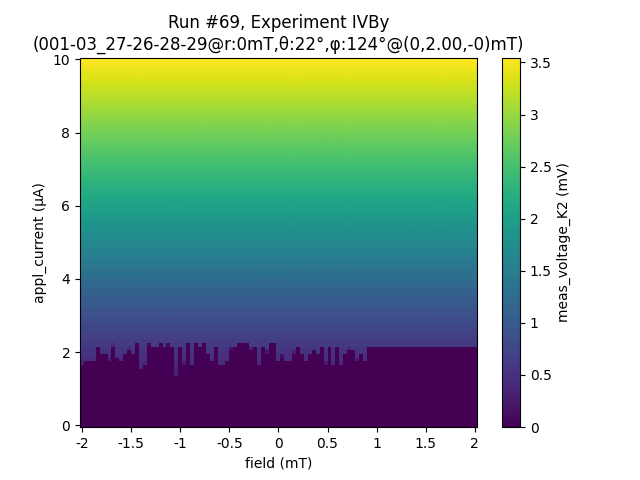

In [34]:
Mag    =2e-3
I_range=10e-6


Mag_x, Mag_y, Mag_z = get_Mag(False)
r_meas, theta, phi = spherical_measured()
r_total = (r_meas[0]**2 + r_meas[1]**2 + r_meas[2]**2)**0.5
print(f"Measured field = {r_meas} T")
print(f"R = {r_total*1e3:.4f} mT")
print(f"Theta measured = {theta}")
print(f"Phi measured = {phi}")
magnet_y.field(Mag)
sleep(120)
appl_current(-I_range)
sleep(5)
exp = qc.new_experiment('IVBy', sample_name=f'001-03_27-26-28-29@r:{r_total*1e3:.0f}mT,θ:{theta:.0f}°,φ:{phi:.0f}°@({Mag_x*1e3:.0f},{Mag*1e3:.2f},{Mag_z*1e3:.0f})mT')

dataid = do2d(magnet_y.field, Mag, -Mag, 101 , 1, appl_current, 0 ,I_range,  101, 0.001, meas_voltage_K2)

appl_current(0)

plot_by_id(dataid)
save_path = r"C:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2\019\LTPlot\{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)
fig1, fig2 = plot_heatmaps(dataid)
magnet_y.field(0)
sleep(5)
get_Mag()

### Set spherical field target

In [35]:
def get_Mag_sphe():
    r_meas, theta, phi = spherical_measured()
    r_total = (r_meas[0]**2 + r_meas[1]**2 + r_meas[2]**2)**0.5
    print(f"Measured field = {r_meas} T")
    print(f"R = {r_total*1e3:.4f} mT")
    print(f"Theta measured = {theta}")
    print(f"Phi measured = {phi}")
    return r_meas, theta, phi, r_total

In [128]:
field_target_spherical = [0e-3, 0, 0]
i3d.spherical(field_target_spherical)
sleep(5)
r_meas, theta, phi = spherical_measured()
r_total = (r_meas[0]**2 + r_meas[1]**2 + r_meas[2]**2)**0.5
print(f"Measured field = {r_meas} T")
print(f"R = {r_total*1e3:.4f} mT")
print(f"Theta measured = {theta}")
print(f"Phi measured = {phi}")

Measured field = [-5.09e-07, 5.58e-07, -2.46e-06] T
R = 0.0026 mT
Theta measured = 18.36842989753231
Phi measured = -0.0


### - to +

In [73]:
Center    =0e-6 
Mag_range =300e-6
I_range   =250e-6

Mag_x, Mag_y, Mag_z = get_Mag(False)
r_meas, theta, phi, r_total = get_Mag_sphe()
magnet_y.field(Center+Mag_range)
mag_start = magnet_y.field()
sleep(120)
exp = qc.new_experiment('IVBy', sample_name=f'002-01_20-21-31-32@r:{r_total*1e3:.0f}mT,θ:{theta:.0f}°,φ:{phi:.0f}°@({Mag_x*1e3:.2f},{mag_start*1e3:.2f},{Mag_z*1e3:.2f})mT')
dataid = do2d(magnet_y.field, Center+Mag_range, Center-Mag_range, 121 , 1, appl_current, 0 ,I_range, 101, 0.001, meas_voltage_K2)# ±2mT 201points, Step size: 20μT
appl_current(0)

# plot_by_id(dataid)
# save_path = r"C:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2\019\LTPlot\{}.png".format(dataid)  # Path to save the plot image
# autosave_plot_by_id(dataid, save_path)
fig1, fig2 = plot_heatmaps(dataid)
magnet_y.field(0)
sleep(5)
get_Mag()

Measured field = [2.42e-07, -2.4e-08, 3.28e-06] T
R = 0.0033 mT
Theta measured = 153.05266646301905
Phi measured = 180.0
Starting experimental run with id: 78. 


first parameter: 100%|██████████| 121/121 [13:27<00:00,  6.67s/it]


ID               : 78
Type             : IVBy
Sample           : 002-01_20-21-31-32@r:0mT,θ:153°,φ:180°@(0.00,0.10,0.00)mT
Run time         : 13 min 28 sec
Parameter unit: 
- meas_voltage_K2: V
- y_field        : T
- appl_current   : A

Number of points for each parameter in dataset 78:
- meas_voltage_K2 (dependent): 12221 points
- y_field          (setpoint): 121 unique points, from -3.00e-04 to 3.00e-04, step size: 5.00e-06
- appl_current     (setpoint): 101 unique points, from 0.00e+00 to 2.50e-04, step size: 2.50e-06
計算微分電阻 dV/dI，使用電壓: meas_voltage_K2 和電流: appl_current
已添加dV_dI列到數據框
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12221 entries, 0 to 12220
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   y_field          12221 non-null  float64
 1   appl_current     12221 non-null  float64
 2   meas_voltage_K2  12221 non-null  float64
 3   dV_dI            12221 non-null  float64
dtypes: float64(4)
mem

Mag_x: 0.000267 mT
Mag_y: -0.001578 mT
Mag_z: -0.004264 mT


In [72]:
fig1, fig2 = plot_heatmaps(75)

ID               : 75
Type             : IVBy
Sample           : 002-05_01-02-47-48@r:0mT,θ:152°@(0.00,0.03,-0.00)mT
Run time         : 7 min 8 sec
Parameter unit: 
- meas_voltage_K2: V
- y_field        : T
- appl_current   : A

Number of points for each parameter in dataset 75:
- meas_voltage_K2 (dependent): 6161 points
- y_field          (setpoint): 61 unique points, from -1.50e-04 to 1.50e-04, step size: 5.00e-06
- appl_current     (setpoint): 101 unique points, from -5.00e-04 to 5.00e-04, step size: 1.00e-05
計算微分電阻 dV/dI，使用電壓: meas_voltage_K2 和電流: appl_current
已添加dV_dI列到數據框
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6161 entries, 0 to 6160
Data columns (total 4 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   y_field          6161 non-null   float64
 1   appl_current     6161 non-null   float64
 2   meas_voltage_K2  6161 non-null   float64
 3   dV_dI            6161 non-null   float64
dtypes: float64(4)
memory usage: 

### Ic+

#### ±2mT
- 201points, Step size: 20μT

Measured field = [0.02121328, -4.37e-07, 0.021211818] T
R = 29.9991 mT
Theta measured = 45.00399364431978
Phi measured = 0.0004591523048407338
Starting experimental run with id: 190. 


first parameter: 100%|██████████| 201/201 [37:57<00:00, 11.33s/it]
Trying to mark a run completed that was already completed.
Trying to mark a run completed that was already completed.


ID               : 190
Type             : IVBy
Sample           : 019-01_29-30-28-27@r:30mT,θ:45.0°@(21.21,2.00,21.21)mT
Run time         : 37 min 57 sec
Parameter unit: 
- meas_voltage_K2: V
- y_field        : T
- appl_current   : A

Number of points for each parameter in dataset 190:
- meas_voltage_K2 (dependent): 30351 points
- y_field          (setpoint): 201 unique points, from -2.00e-03 to 2.00e-03, step size: 2.00e-05
- appl_current     (setpoint): 151 unique points, from 0.00e+00 to 3.00e-05, step size: 2.00e-07
           y_field  appl_current  meas_voltage_K2         dV_dI
count  30351.00000  30351.000000     3.035100e+04  30351.000000
mean       0.00000      0.000015     9.436527e-06      0.748873
std        0.00116      0.000009     7.323626e-06      1.699122
min       -0.00200      0.000000    -9.289096e-07     -0.320941
25%       -0.00100      0.000007     2.203133e-06      0.655665
50%        0.00000      0.000015     9.437052e-06      0.746200
75%        0.00100      0.

Mag_x: 21.212747 mT
Mag_y: -0.001141 mT
Mag_z: 21.210506 mT


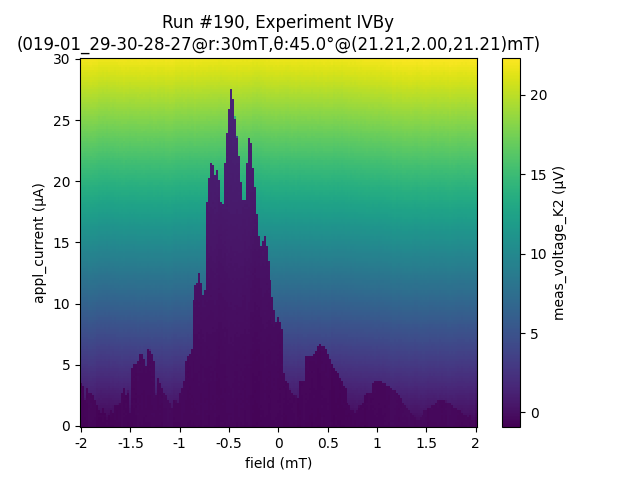

In [ ]:
Center    =0e-6 
Mag_range =2e-3
I_range   =30e-6

Mag_x, Mag_y, Mag_z = get_Mag(False)
r_meas, theta, phi, r_total = get_Mag_sphe()
magnet_y.field(Center+Mag_range)
mag_start = magnet_y.field()
sleep(120)
exp = qc.new_experiment('IVBy', sample_name=f'001-03_27-26-28-29@r:{r_total*1e3:.0f}mT,θ:{theta:.0f}°@({Mag_x*1e3:.2f},{mag_start*1e3:.2f},{Mag_z*1e3:.2f})mT')
dataid = do2d(magnet_y.field, Center+Mag_range, Center-Mag_range, 201 , 1, appl_current, 0 ,I_range, 151, 0.03, meas_voltage_K2)# ±2mT 201points, Step size: 20μT
appl_current(0)

plot_by_id(dataid)
save_path = r"C:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2\019\LTPlot\{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)
fig1, fig2 = plot_heatmaps(dataid)
magnet_y.field(0)
sleep(5)
get_Mag()

In [100]:
def get_Mag_sphe():
    r_meas, theta, phi = spherical_measured()
    r_total = (r_meas[0]**2 + r_meas[1]**2 + r_meas[2]**2)**0.5
    print(f"Measured field = {r_meas} T")
    print(f"R = {r_total*1e3:.4f} mT")
    print(f"Theta measured = {theta}")
    print(f"Phi measured = {phi}")
    return r_meas, theta, phi, r_total

#### ±300μT
- 121points, Step size: 5μT

Measured field = [0.021213498, -5.1e-07, 0.02121067] T
R = 29.9984 mT
Theta measured = 45.000129654225745
Phi measured = 0.0011802955745060086
Starting experimental run with id: 191. 


first parameter: 100%|██████████| 121/121 [22:49<00:00, 11.32s/it]
Trying to mark a run completed that was already completed.
Trying to mark a run completed that was already completed.


ID               : 191
Type             : IVBy
Sample           : 019-01_29-30-28-27@r:30mT,θ:45.0°@(21.21,0.30,21.21)mT
Run time         : 22 min 50 sec
Parameter unit: 
- meas_voltage_K2: V
- y_field        : T
- appl_current   : A

Number of points for each parameter in dataset 191:
- meas_voltage_K2 (dependent): 18271 points
- y_field          (setpoint): 121 unique points, from -7.80e-04 to -1.80e-04, step size: 5.00e-06
- appl_current     (setpoint): 151 unique points, from 0.00e+00 to 3.00e-05, step size: 2.00e-07
            y_field  appl_current  meas_voltage_K2         dV_dI
count  18271.000000  18271.000000     1.827100e+04  18271.000000
mean      -0.000480      0.000015     5.393671e-06      0.741687
std        0.000175      0.000009     8.233804e-06      4.020328
min       -0.000780      0.000000    -1.193650e-06     -0.241898
25%       -0.000630      0.000007    -1.281891e-07      0.046674
50%       -0.000480      0.000015     4.488455e-07      0.110817
75%       -0.00033

Mag_x: 21.213402 mT
Mag_y: -0.000850 mT
Mag_z: 21.216738 mT


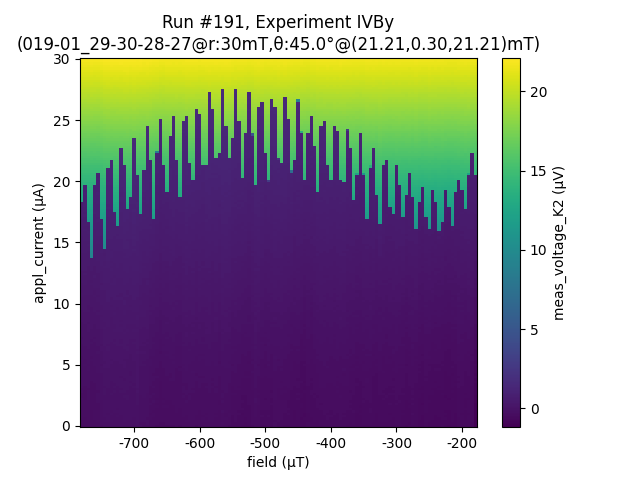

In [126]:
Center    =-480e-6 
Mag_range =300e-6
I_range   =30e-6

Mag_x, Mag_y, Mag_z = get_Mag(False)
r_meas, theta, phi, r_total = get_Mag_sphe()
magnet_y.field(Center+Mag_range)
sleep(120)
exp = qc.new_experiment('IVBy', sample_name=f'019-01_29-30-28-27@r:{r_total*1e3:.0f}mT,θ:{theta:.1f}°@({Mag_x*1e3:.2f},{Mag_range*1e3:.2f},{Mag_z*1e3:.2f})mT')
dataid = do2d(magnet_y.field, Center+Mag_range, Center-Mag_range, 121 , 1, appl_current, 0 ,I_range, 151, 0.03, meas_voltage_K2)# ±300μT 121points, Step size: 5μT
appl_current(0)

plot_by_id(dataid)
save_path = r"C:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2\019\LTPlot\{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)
fig1, fig2 = plot_heatmaps(dataid)
magnet_y.field(0)
sleep(5)
get_Mag()

#### ±40μT
- 321points, Step size: 0.25μT

Measured field = [0.021213498, -6.31e-07, 0.021214114] T
R = 30.0009 mT
Theta measured = 45.0039127368757
Phi measured = -0.0021634102808774825
Starting experimental run with id: 192. 


first parameter: 100%|██████████| 321/321 [1:00:30<00:00, 11.31s/it]
Trying to mark a run completed that was already completed.
Trying to mark a run completed that was already completed.


ID               : 192
Type             : IVBy
Sample           : 019-01_29-30-28-27@r:30mT,θ:45.0°@(21.21,0.04,21.22)mT
Run time         : 1 hr
Parameter unit: 
- meas_voltage_K2: V
- y_field        : T
- appl_current   : A

Number of points for each parameter in dataset 192:
- meas_voltage_K2 (dependent): 48471 points
- y_field          (setpoint): 321 unique points, from -5.90e-04 to -5.10e-04, step size: 2.50e-07
- appl_current     (setpoint): 151 unique points, from 0.00e+00 to 3.00e-05, step size: 2.00e-07
            y_field  appl_current  meas_voltage_K2         dV_dI
count  48471.000000  48471.000000     4.847100e+04  48471.000000
mean      -0.000550      0.000015     4.100226e-06      0.727691
std        0.000023      0.000009     7.576874e-06      4.487598
min       -0.000590      0.000000    -7.782473e-07     -0.283617
25%       -0.000570      0.000007    -7.509125e-08      0.041459
50%       -0.000550      0.000015     5.117535e-07      0.097445
75%       -0.000530      0.

Mag_x: 21.213717 mT
Mag_y: -0.001117 mT
Mag_z: 21.211818 mT


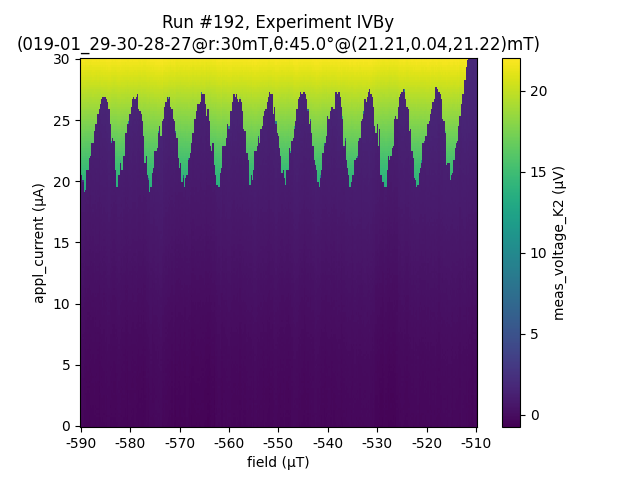

In [127]:
Center    =-550e-6 
Mag_range =40e-6
I_range   =30e-6


Mag_x, Mag_y, Mag_z = get_Mag(False)
r_meas, theta, phi, r_total = get_Mag_sphe()
magnet_y.field(Center+Mag_range)
sleep(120)

exp = qc.new_experiment('IVBy', sample_name=f'019-01_29-30-28-27@r:{r_total*1e3:.0f}mT,θ:{theta:.1f}°@({Mag_x*1e3:.2f},{Mag_range*1e3:.2f},{Mag_z*1e3:.2f})mT')
dataid = do2d(magnet_y.field, Center+Mag_range, Center-Mag_range, 321 , 1, appl_current, 0 ,I_range,  151, 0.03, meas_voltage_K2)# ±40μT 321points, Step size: 0.25μT
appl_current(0)

plot_by_id(dataid)
save_path = r"C:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2\019\LTPlot\{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)
fig1, fig2 = plot_heatmaps(dataid)
magnet_y.field(0)
sleep(5)
get_Mag()

### Ic-

#### ±2mT
- 201points, Step size: 20μT

Measured field = [-0.009999397, -5.58e-07, -4.428e-06] T
R = 9.9994 mT
Theta measured = 90.00093962541294
Phi measured = 179.99610391660934
Starting experimental run with id: 179. 


first parameter: 100%|██████████| 201/201 [37:37<00:00, 11.23s/it]
Trying to mark a run completed that was already completed.
Trying to mark a run completed that was already completed.


ID               : 179
Type             : IVBy
Sample           : 019-01_29-30-28-27@r:10mT,θ:90.0°@(-10.00,2.00,-0.00)mT
Run time         : 37 min 38 sec
Parameter unit: 
- meas_voltage_K2: V
- y_field        : T
- appl_current   : A

Number of points for each parameter in dataset 179:
- meas_voltage_K2 (dependent): 30351 points
- y_field          (setpoint): 201 unique points, from -2.00e-03 to 2.00e-03, step size: 2.00e-05
- appl_current     (setpoint): 151 unique points, from -3.00e-05 to 0.00e+00, step size: 2.00e-07
           y_field  appl_current  meas_voltage_K2         dV_dI
count  30351.00000  30351.000000     30351.000000  30351.000000
mean       0.00000     -0.000015        -0.000010      0.661452
std        0.00116      0.000009         0.000007      1.572175
min       -0.00200     -0.000030        -0.000022     -0.390375
25%       -0.00100     -0.000023        -0.000016      0.575889
50%        0.00000     -0.000015        -0.000011      0.662220
75%        0.00100     -

Mag_x: -10.000270 mT
Mag_y: -0.001505 mT
Mag_z: 0.000328 mT


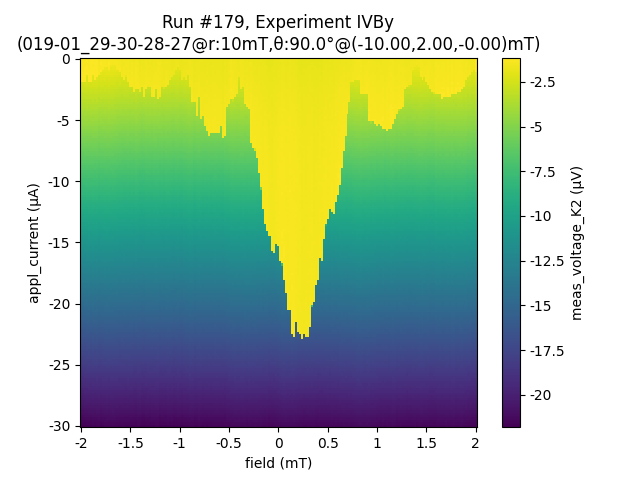

In [108]:
Center    =0e-6 
Mag_range =2e-3
I_range   =30e-6

Mag_x, Mag_y, Mag_z = get_Mag(False)
r_meas, theta, phi, r_total = get_Mag_sphe()
magnet_y.field(Center+Mag_range)
sleep(120)
exp = qc.new_experiment('IVBy', sample_name=f'019-01_29-30-28-27@r:{r_total*1e3:.0f}mT,θ:{theta:.1f}°@({Mag_x*1e3:.2f},{Mag_range*1e3:.2f},{Mag_z*1e3:.2f})mT')
dataid = do2d(magnet_y.field, Center+Mag_range, Center-Mag_range, 201 , 1, appl_current, 0 ,-I_range, 151, 0.03, meas_voltage_K2)# ±2mT 201points, Step size: 20μT
appl_current(0)

plot_by_id(dataid)
save_path = r"C:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2\019\LTPlot\{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)
fig1, fig2 = plot_heatmaps(dataid)
magnet_y.field(0)
sleep(5)
get_Mag()

#### ±300μT
- 121points, Step size: 5μT

Measured field = [-0.010000706, 9.7e-08, 8.2e-07] T
R = 10.0007 mT
Theta measured = 90.01597351659298
Phi measured = -179.9994442364964
Starting experimental run with id: 180. 


first parameter: 100%|██████████| 121/121 [22:31<00:00, 11.17s/it]
Trying to mark a run completed that was already completed.
Trying to mark a run completed that was already completed.


ID               : 180
Type             : IVBy
Sample           : 019-01_29-30-28-27@r:10mT,θ:90.0°@(-10.00,0.30,-0.00)mT
Run time         : 22 min 32 sec
Parameter unit: 
- meas_voltage_K2: V
- y_field        : T
- appl_current   : A

Number of points for each parameter in dataset 180:
- meas_voltage_K2 (dependent): 18271 points
- y_field          (setpoint): 121 unique points, from 0.00e+00 to 6.00e-04, step size: 5.00e-06
- appl_current     (setpoint): 151 unique points, from -3.00e-05 to 0.00e+00, step size: 2.00e-07
            y_field  appl_current  meas_voltage_K2         dV_dI
count  18271.000000  18271.000000     1.827100e+04  18271.000000
mean       0.000300     -0.000015    -6.598940e-06      0.658232
std        0.000175      0.000009     7.527322e-06      3.827317
min        0.000000     -0.000030    -2.148078e-05     -0.276803
25%        0.000150     -0.000023    -1.449185e-05     -0.032201
50%        0.000300     -0.000015    -1.367732e-06      0.039748
75%        0.00045

Mag_x: -10.000148 mT
Mag_y: 0.000510 mT
Mag_z: -0.001148 mT


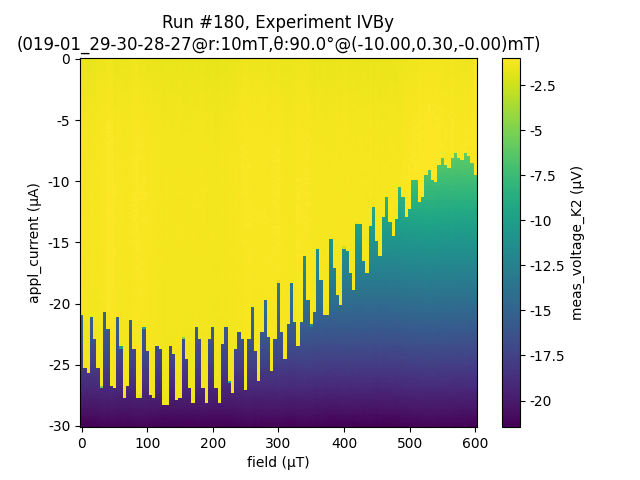

In [109]:
Center    =300e-6 
Mag_range =300e-6
I_range   =30e-6

Mag_x, Mag_y, Mag_z = get_Mag(False)
r_meas, theta, phi, r_total = get_Mag_sphe()
magnet_y.field(Center+Mag_range)
sleep(120)
exp = qc.new_experiment('IVBy', sample_name=f'019-01_29-30-28-27@r:{r_total*1e3:.0f}mT,θ:{theta:.1f}°@({Mag_x*1e3:.2f},{Mag_range*1e3:.2f},{Mag_z*1e3:.2f})mT')
dataid = do2d(magnet_y.field, Center+Mag_range, Center-Mag_range, 121 , 1, appl_current, 0 ,-I_range, 151, 0.03, meas_voltage_K2)# ±300μT 121points, Step size: 5μT
appl_current(0)

plot_by_id(dataid)
save_path = r"C:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2\019\LTPlot\{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)
fig1, fig2 = plot_heatmaps(dataid)
magnet_y.field(0)
sleep(5)
get_Mag()

#### ±40μT
- 321points, Step size: 0.25μT

Measured field = [-0.009999809, -3.64e-07, -6.56e-07] T
R = 9.9998 mT
Theta measured = 90.03194718409378
Phi measured = -179.9968028731266
Starting experimental run with id: 189. 


first parameter: 100%|██████████| 321/321 [1:00:19<00:00, 11.28s/it]
Trying to mark a run completed that was already completed.
Trying to mark a run completed that was already completed.


ID               : 189
Type             : IVBy
Sample           : 019-01_29-30-28-27@r:10mT,θ:90.0°@(-10.00,0.04,-0.00)mT
Run time         : 1 hr
Parameter unit: 
- meas_voltage_K2: V
- y_field        : T
- appl_current   : A

Number of points for each parameter in dataset 189:
- meas_voltage_K2 (dependent): 48471 points
- y_field          (setpoint): 321 unique points, from 1.00e-04 to 1.80e-04, step size: 2.50e-07
- appl_current     (setpoint): 151 unique points, from -3.00e-05 to 0.00e+00, step size: 2.00e-07
            y_field  appl_current  meas_voltage_K2         dV_dI
count  48471.000000  48471.000000     4.847100e+04  48471.000000
mean       0.000140     -0.000015    -5.219242e-06      0.732614
std        0.000023      0.000009     6.900370e-06      4.818839
min        0.000100     -0.000030    -2.417883e-05     -0.283543
25%        0.000120     -0.000023    -3.177328e-06      0.037360
50%        0.000140     -0.000015    -2.468373e-06      0.090517
75%        0.000160     -0.

Mag_x: -10.000609 mT
Mag_y: 0.000753 mT
Mag_z: 0.001312 mT


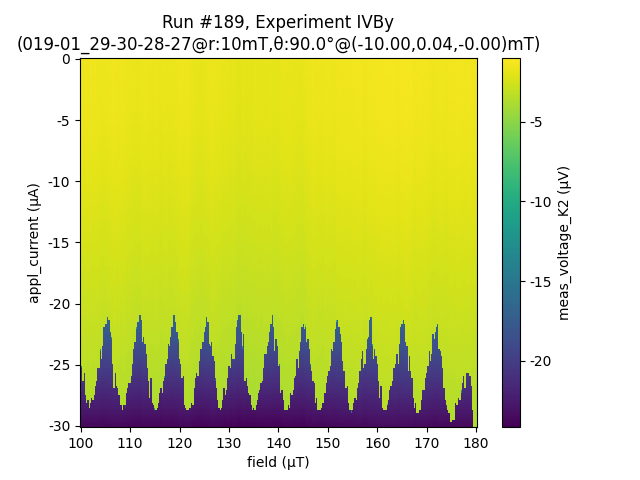

In [122]:
Center    =140e-6 
Mag_range =40e-6
I_range   =30e-6

Mag_x, Mag_y, Mag_z = get_Mag(False)
r_meas, theta, phi, r_total = get_Mag_sphe()
magnet_y.field(Center+Mag_range)
sleep(120)
exp = qc.new_experiment('IVBy', sample_name=f'019-01_29-30-28-27@r:{r_total*1e3:.0f}mT,θ:{theta:.1f}°@({Mag_x*1e3:.2f},{Mag_range*1e3:.2f},{Mag_z*1e3:.2f})mT')
dataid = do2d(magnet_y.field, Center+Mag_range, Center-Mag_range, 321 , 1, appl_current, 0 ,-I_range, 151, 0.03, meas_voltage_K2)# ±40μT 321points, Step size: 0.25μT
appl_current(0)

plot_by_id(dataid)
save_path = r"C:\Users\admin\Documents\GitHub\QCoDeS_local\personal_scripts\Albert\PtTe2\019\LTPlot\{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)
fig1, fig2 = plot_heatmaps(dataid)
magnet_y.field(0)
sleep(5)
get_Mag()

In [41]:
magnet_y.field()

0.000749954

## IV vs Bz

In [ ]:
K2440.output(1)
sleep(2)
magnet_z.field(-80e-3)
sleep(60)
appl_current(-2e-7)
sleep(5)

# station.snapshot(update=True);

exp = qc.new_experiment('IV vs Bz', sample_name='IV_Bz_33_32_30_31_10M_forward')

dataid = do2d(magnet_z.field,-80e-3,80e-3, 71 , 20, appl_current, -2e-7 ,2e-7, 101, 0.05, meas_voltage_K2)

appl_current(0)

K2440.output(0)
# magnet_y.field(0)

plot_by_id(dataid)

In [ ]:
#magnet_z.field(20e-3)
#sleep(5)
magnet_z.field(-6.1e-3)
sleep(5)

## IV w/ Bx

In [ ]:
K2440.output(1)
sleep(2)
magnet_x.field(0.23e-3)
appl_current(-0.5e-6)
sleep(10)

# station.snapshot(update=True);
exp = qc.new_experiment('I vs V', sample_name='IV_w/_Bx')

#do1d(param_set, start, stop, num_points, delay, *param_meas)
dataid = do1d(appl_current, -0.5e-6 ,0.5e-6, 101, 0.05, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()

appl_current(0)
plot_by_id(dataid)
# print(get_R_from_IV(dataid))
#print(get_R_from_IV_2(dataid))

K2440.output(0)

## IV w/ By

In [ ]:
K2440.output(1)
DMM6500.averaging_count(30)
#DMM6500.averaging_enabled(False)

sleep(2)
magnet_y.field(0e-3)
appl_current(-2e-7)
sleep(20)

# station.snapshot(update=True);
exp = qc.new_experiment('I vs V', sample_name='IV_w/_By@0mT_forward_Avg30')

#do1d(param_set, start, stop, num_points, delay, *param_meas)
dataid = do1d(appl_current, -2e-7 ,2e-7, 201, 0.05, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()

appl_current(0)
plot_by_id(dataid)
# print(get_R_from_IV(dataid))
#print(get_R_from_IV_2(dataid))

K2440.output(0)

## MR

In [ ]:
K2440.output(1)
sleep(2)
magnet_y.field(-0.1)
sleep(5)
#K2440.output(1)
appl_current(1e-7)
sleep(5)

# station.snapshot(update=True);

exp = qc.new_experiment('I vs By_MR', sample_name='072_14IVf_25_24_29_29_By_+-0.1T_MR_for')

dataid = do1d(magnet_y.field, -0.1, 0.1, 71 , 1, meas_voltage_K2)

appl_current(0)
K2440.output(0)
#K2440.output(0)
magnet_y.field(0)

plot_by_id(dataid)

## IV w/Bz

In [ ]:
K2440.output(1)
DMM6500.averaging_count(10)
#DMM6500.averaging_enabled(False)

sleep(2)
magnet_z.field(0e-3)
appl_current(-2e-7)
sleep(30)

# station.snapshot(update=True);
exp = qc.new_experiment('I vs V', sample_name='IV_w/_f_Bz@0mT_forward_Avg10')

#do1d(param_set, start, stop, num_points, delay, *param_meas)
dataid = do1d(appl_current, -2e-7 ,2e-7, 201, 0.05, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()

appl_current(0)
plot_by_id(dataid)
# print(get_R_from_IV(dataid))
#print(get_R_from_IV_2(dataid))

K2440.output(0)

# Zero everything

In [ ]:
appl_current(0)
appl_TG(0)
magnet_y.field(0)
sleep(5)
magnet_x.field(0)
sleep(5)
magnet_z.field(0)
sleep(5)
#appl_voltage_AC(0.004)
#SGS.off()
K2440.output(0)

In [ ]:
appl_current(0)

# Gate simple sweeps

## 加TG (2D)

In [ ]:
appl_current(0)
sleep(1)
appl_TG(0)
sleep(5)

In [ ]:
magnet_x.field(-0.044e-3)
sleep(10)
magnet_y.field(-6.016e-3)
sleep(10)

In [ ]:
K2440.output(1)
K2440.output(1)
appl_TG(-30)
sleep(5)
appl_current(-1.5e-8)
sleep(1)

exp = qc.new_experiment('I_vs_Vgate_up', sample_name='33_32_30_31_1M_TG21')
dataid = do2d(appl_TG, -30, 30, 301, 0.5, appl_current, -1.5e-8, 1.5e-8, 101, 0.1, meas_voltage_K2)

appl_TG(0)
sleep(5)
appl_current(0e-7)
sleep(5)

K2440.output(0)
K2440.output(0)

plot_by_id(dataid)

# RF

## I vs RF_f

### sensitive check

In [ ]:
SGS.power()
SGS.frequency()

In [ ]:
SGS.on()

In [ ]:
SGS.off()

In [ ]:
magnet_x.field(0.4e-3)
sleep(10)
magnet_y.field(2.53e-3)
sleep(10)

In [ ]:
DMM6500.averaging_count(5)
DMM6500.averaging_enabled(False)

### I vs RF_f (1D)

In [ ]:
SGS.off()
exp = qc.new_experiment('I-RF_f', sample_name='103-06_J2_12-13-14-15_1M_@0mT')
SGS.power(0)
SGS.frequency(0.1e9)
SGS.on()
sleep(1)
DMM6500.averaging_count(5)
DMM6500.averaging_enabled(False)
K2440.output(1)

appl_current(0.4e-6)
#appl_TG(10)
# magnet_x.field(0.4e-3)
# magnet_y.field(2.53e-3)

dataid = do1d(SGS.frequency, 11.4e9, 12.2e9, 201, 0.1, meas_voltage_K2)
appl_current(0)
SGS.off()
K2440.output(0)
plot_by_id(dataid)


### I vs RF_f (2D)

In [ ]:
SGS.off()

In [ ]:
SGS.off()
SGS.power(0)
SGS.frequency(0.1e9)
SGS.on()
DMM6500.averaging_count(1)
DMM6500.averaging_enabled(False)
K2440.output(1)

I_range = 8e-6
appl_current(-I_range)
#appl_TG(-10)
# magnet_x.field(0.4e-3)
# magnet_y.field(2.53e-3)
# sleep(1)

# station.snapshot(update=True);
exp = qc.new_experiment('IV-RF_f', sample_name=f'103-03_J2_27-26-30-31M(32G-33G-28G-29G)_1M_RF@0dBm_By@0.1mT')

#do1d(param_set, start, stop, num_points, delay, *param_meas)
dataid = do2d(SGS.frequency, 1e9, 20e9, 191, 0.0001, appl_current,-I_range ,I_range, 201, 0.0001, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()
K2440.output(0)
SGS.off()
appl_current(0)
plot_by_id(dataid)
save_path = r"D:\data\Albert\103\Plot\104_{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)

In [ ]:
SGS.off()
SGS.power(20)
SGS.frequency(0.1e9)
SGS.on()
DMM6500.averaging_count(1)
DMM6500.averaging_enabled(False)
K2440.output(1)

I_range = 6e-6
appl_current(-I_range)
#appl_TG(-10)
# magnet_x.field(0.4e-3)
# magnet_y.field(2.53e-3)
# sleep(1)

# station.snapshot(update=True);
exp = qc.new_experiment('IV-RF_f', sample_name=f'103-03_J2_27-26-30-31M(32G-33G-28G-29G)_1M_RF@-10dBm_By@0.1mT')

#do1d(param_set, start, stop, num_points, delay, *param_meas)
dataid = do2d(SGS.frequency, 1e9, 20e9, 191, 0.0001, appl_current,-I_range ,I_range, 201, 0.0001, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()
K2440.output(0)
SGS.off()
appl_current(0)
plot_by_id(dataid)
save_path = r"D:\data\Albert\103\Plot\104_{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)

In [ ]:
SGS.off()
SGS.power(20)
SGS.frequency(5.9e9)
SGS.on()
DMM6500.averaging_count(1)
DMM6500.averaging_enabled(False)
K2440.output(1)

I_range = 6e-6
appl_current(-I_range)
#appl_TG(-10)
# magnet_x.field(0.4e-3)
# magnet_y.field(2.53e-3)
# sleep(1)

# station.snapshot(update=True);
exp = qc.new_experiment('IV-RF_f', sample_name=f'103-03_J2_27-26-30-31M(32G-33G-28G-29G)_1M_RF@20dBm_By@0.1mT')

#do1d(param_set, start, stop, num_points, delay, *param_meas)
dataid = do2d(SGS.frequency, 5.9e9, 6.0e9, 251, 0.0001, appl_current,-I_range ,I_range, 501, 0.0001, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()
K2440.output(0)
SGS.off()
appl_current(0)
plot_by_id(dataid)
save_path = r"D:\data\Albert\103\Plot\104_{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)


In [ ]:
SGS.off()
SGS.power(20)
SGS.frequency(5.535e9)
SGS.on()
DMM6500.averaging_count(1)
DMM6500.averaging_enabled(False)
K2440.output(1)

I_range = 6e-6
appl_current(-I_range)
#appl_TG(-10)
# magnet_x.field(0.4e-3)
# magnet_y.field(2.53e-3)
# sleep(1)

# station.snapshot(update=True);
exp = qc.new_experiment('IV-RF_f', sample_name=f'103-03_J2_27-26-30-31M(32G-33G-28G-29G)_1M_RF@20dBm_By@0.1mT')

#do1d(param_set, start, stop, num_points, delay, *param_meas)
dataid = do2d(SGS.frequency, 5.535e9, 5.585e9, 251, 0.0001, appl_current,-I_range ,I_range, 501, 0.0001, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()
K2440.output(0)
SGS.off()
appl_current(0)
plot_by_id(dataid)
save_path = r"D:\data\Albert\103\Plot\104_{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)


In [ ]:
SGS.off()
SGS.power(20)
SGS.frequency(0.1e9)
SGS.on()
DMM6500.averaging_count(1)
DMM6500.averaging_enabled(False)
K2440.output(1)

I_range = 6e-6
appl_current(-I_range)
SGS_power = SGS.power()
#appl_TG(-10)
# magnet_x.field(0.4e-3)
# magnet_y.field(2.53e-3)
# sleep(1)

# station.snapshot(update=True);
exp = qc.new_experiment('IV-RF_f', sample_name=f'103-03_J2_27-26-30-31M(32G-33G-28G-29G)_1M_RF@{SGS_power}dBm_By@0.1mT')

#do1d(param_set, start, stop, num_points, delay, *param_meas)
dataid = do2d(SGS.frequency, 3.9e9, 6.9e9, 301, 0.0001, appl_current,-I_range ,I_range, 251, 0.0001, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()
K2440.output(0)
SGS.off()
appl_current(0)
plot_by_id(dataid)
save_path = r"D:\data\Albert\103\Plot\104_{}.png".format(dataid)  # Path to save the plot image
autosave_plot_by_id(dataid, save_path)

In [ ]:
appl_current(0)
#appl_TG(0)
magnet_y.field(0)
sleep(2)
magnet_x.field(0)
sleep(2)
#appl_voltage_AC(0.004)
SGS.off()

## IV vs RF_f

### Shapiro steps 

In [ ]:
SGS.off()
SGS.power(-10)
SGS.frequency(11.725e9)
SGS.on()
DMM6500.averaging_count(5)
DMM6500.averaging_enabled(False)
K2440.output(1)

appl_current(-2e-7)
#appl_TG(-10)
#magnet_x.field(0.23e-3)
#magnet_y.field(1.41e-3)
# sleep(1)

# station.snapshot(update=True);
exp = qc.new_experiment('IV-RF_f', sample_name=f'103-03_J2_27-26-30-31M(32G-33G-28G-29G)_1M_By@0.1mT{-I_range}')

#do1d(param_set, start, stop, num_points, delay, *param_meas)""
dataid = do1d(appl_current,-2e-7 ,2e-7, 101, 0.05,  meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()
K2440.output(0)
SGS.off()
appl_current(0)
plot_by_id(dataid)
# print(get_R_from_IV(dataid))
#print(get_R_from_IV_2(dataid))

In [ ]:
SGS.off()
SGS.power(0)
SGS.frequency(3.87e9)
SGS.on()
DMM6500.averaging_count(5)
DMM6500.averaging_enabled(False)
K2440.output(1)

appl_current(-1.2e-6)
#appl_TG(-10)
magnet_y.field(-10e-3)

#magnet_y.field(1.41e-3)
# sleep(1)

# station.snapshot(update=True);
exp = qc.new_experiment('Bx vs RF_f', sample_name='By vs RF_f_J2_3.87_-10dB')

#do1d(param_set, start, stop, num_points, delay, *param_meas)""
dataid = do2d(magnet_y.field, -10e-3, 10e-3,701, 1, appl_current,-1.2e-6 ,1.2e-6, 101, 0.05,  meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()
K2440.output(0)
SGS.off()
appl_current(0)
plot_by_id(dataid)
# print(get_R_from_IV(dataid))
#print(get_R_from_IV_2(dataid))

In [ ]:
appl_current(0)
#appl_TG(0)
magnet_y.field(0)
sleep(10)
magnet_x.field(0)
sleep(10)
#appl_voltage_AC(0.004)
SGS.off()

## IV vs Power Dependence

In [ ]:
SGS.off()

In [ ]:
SGS.power(-40)

In [ ]:
SGS.off()

In [ ]:
SGS.off()
SGS.power(-20)
SGS.frequency(5.9534e9)
SGS_frequency = SGS.frequency()
SGS.on()
DMM6500.averaging_count(3)
DMM6500.averaging_enabled(False)
K2440.output(1)

#magnet_x.field(15e-3)
#sleep(5)
I_range = 6e-6
appl_current(-I_range)
#appl_TG(-30)
sleep(2)

# station.snapshot(update=True);
exp = qc.new_experiment('IV-RF_p', sample_name=f'103-03_J2_27-26-30-31M(32G-33G-28G-29G)_1M_RF@{SGS_frequency*1e-9:.4f}GHz_By@0.1mT')

#do1d(param_set, start, stop, num_points, delay, *param_meas)

dataid = do2d(SGS.power,10, 15, 51, 0.1, appl_current,-I_range ,I_range, 301, 0.00001, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()

SGS.off()
appl_current(0)
K2440.output()
plot_by_id(dataid)

# print(get_R_from_IV(dataid))
print(get_R_from_IV_2(dataid))

In [ ]:
SGS.off()
SGS.power(-25)
SGS.frequency(5.226e9)
SGS.on()
DMM6500.averaging_count(5)
DMM6500.averaging_enabled(True)
K2440.output(1)

magnet_y.field(-8e-3)
sleep(60)
appl_current(-2e-7)
#appl_TG(-30)
sleep(2)

# station.snapshot(update=True);
exp = qc.new_experiment('IV vs power dependence', sample_name='IV vs PD_5.226_By:-8mT')

#do1d(param_set, start, stop, num_points, delay, *param_meas)

dataid = do2d(SGS.power,-25, 10, 101, 20, appl_current,-2e-7 ,2e-7, 101, 0.05, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()

SGS.off()
appl_current(0)
K2440.output()
plot_by_id(dataid)

# print(get_R_from_IV(dataid))
print(get_R_from_IV_2(dataid))

### PD vs frequency_IV loop (not yet)

In [ ]:
frequencies = [3.248, 3.387, 5.677]
power_levels = [-20, 0, 25]
     
SGS.off()
SGS.power(-20)
SGS.frequency(3.387e9)
SGS.on()
DMM6500.averaging_count(5)
DMM6500.averaging_enabled(True)
K2440.output(1)

appl_current(-2e-6)
#appl_TG(-10)
sleep(1)

for freq in frequencies:
    SGS.frequency(freq)
    for power_level in power_levels:
        SGS.power(power_level)

# station.snapshot(update=True);
exp = qc.new_experiment('IV vs power dependence', sample_name='IV vs PD_J2_3.387_m20')
dataid = do2d(SGS.power, 4, 8, 100, 2, appl_current, -1e-6, 1e-6, 101, 0.05, meas_voltage_K2)

 # 關閉設備，並在需要時列印或繪製結果
SGS.off()
appl_current(0)
K2440.output()
plot_by_id(dataid)
    
print(f"頻率：{freq} Hz，功率水平：{power_level} dB")
print(get_R_from_IV_2(dataid))


## IV vs Vgate

In [ ]:
appl_current(0)
appl_TG(0)
magnet_y.field(0)
sleep(10)
magnet_x.field(0)
sleep(10)
appl_voltage_AC(0.004)
SGS.off()

In [ ]:
SGS.off()
SGS.power(25)
SGS.frequency(4.83e9)
SGS.on()
DMM6500.averaging_count(5)
DMM6500.averaging_enabled(True)
appl_current(-0.4e-7)
appl_current_AC(0.1e-10)

appl_TG(-10)
sleep(1)

# station.snapshot(update=True);
exp = qc.new_experiment('IV vs Vgate', sample_name='IV vs Vg')

dataid = do2d(appl_TG, -10, 10, 751, 0.5, appl_current, -0.4e-7, 0.4e-7, 101, 0.01, meas_voltage_AC_L1, meas_voltage_AC_L1_P, meas_voltage_K2)
# dataid = do1d(appl_current, 6e-6 , -6e-6, 251, 0.01, meas_voltage_K1)
# ivvi.set_dacs_zero()
SGS.off()
appl_current(0)
plot_by_id(dataid)
# print(get_R_from_IV(dataid))
#print(get_R_from_IV_2(dataid))

In [ ]:
appl_current(0)
appl_TG(0)
magnet_y.field(0)
sleep(10)
magnet_x.field(0)
sleep(10)
appl_voltage_AC(0.004)
SGS.off()

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

# Constants
k = 8.617333262145e-5  # Boltzmann constant in eV/K
E_a = 0.5  # Example value for the activation energy in eV
p_0 = 1.0  # Example value for p0

# Create an array of temperatures from 100 to 1000 K
temperatures = np.linspace(100, 1000, 50)

# Calculate 1/T
inverse_temperatures = 1 / temperatures

# Calculate ln(p)
ln_p = np.log(p_0) - (E_a / k) * inverse_temperatures

# Plotting
plt.figure(figsize=(8, 6))
plt.plot(inverse_temperatures, ln_p, marker='o', linestyle='-')
plt.xlabel('1/T (1/K)')
plt.ylabel('ln(p)')
plt.title('ln(p) vs 1/T for Hole Concentration')
plt.grid(True)
plt.show()
